In [2]:
# pip install hep_ml

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from hep_ml.reweight import GBReweighter
from hep_ml.metrics_utils import ks_2samp_weighted

In [2]:
data = pd.read_pickle('data/data_tree_df.dat')
mc = pd.read_pickle('data/mc_tree_df.dat')
mc = mc[data.columns.append(pd.Index(['trueKs']))]

data

,v0_rxy,v0_chi2,cosTheta,v0_ks_mass
entry,,,,
0,10.939429,7.692770,-0.932089,486.838989
1,4.536934,8.715455,0.842799,415.244232
2,3.143249,2.268393,-0.937126,379.493164
3,5.141263,0.618207,0.985514,463.033813
4,3.584497,0.038960,-0.999696,299.626312
...,...,...,...,...
5881539,8.186677,0.006104,0.956667,421.240173
5881540,15.166662,0.783050,0.999982,742.005859
5881541,5.398542,3.527910,-0.623123,483.784698


In [3]:
mc

,v0_rxy,v0_chi2,cosTheta,v0_ks_mass,trueKs
entry,,,,,
0,22.167784,2.382054,0.999984,494.268921,1
1,47.610825,3.497677,0.998978,397.069916,0
2,0.817319,0.498025,-0.976455,501.326752,0
3,8.774105,0.005986,0.981570,489.352905,0
4,6.396118,0.059769,-0.814891,476.383453,0
...,...,...,...,...,...
9254565,8.198357,0.682529,0.991236,385.186523,0
9254566,1.744378,13.669016,0.961018,456.092560,0
9254567,37.192600,0.457468,0.984323,388.591278,0


In [30]:
subsample = 50000

train_reweight_mc = mc[:subsample]
train_reweight_data = data[:subsample]

test_reweight_mc = mc[subsample:2*subsample]
train_classifier_data = data[subsample:2*subsample]

test_classifier_mc = mc[2*subsample:3*subsample]
test_classifier_data = data[2*subsample:3*subsample]

In [5]:
def draw_distributions(mc,data,weights,bins=500):
    plt.figure(figsize=(15,8))
    for i, col in enumerate(data.columns,1):
        xlim = np.percentile(np.hstack([data[col]]), [0.01,95])
        plt.subplot(2,2,i)
        plt.hist(mc[col],weights=weights,range=xlim,bins=bins,density=True,alpha=0.7)
        plt.hist(data[col],range=xlim,bins=bins,density=True,alpha=0.7)
        plt.yscale('log')
        plt.title(col+f', KS: {ks_2samp_weighted(mc[col], data[col], weights1=weights, weights2=np.ones(len(data), dtype=float)):.4f}')

The original distributions. MC as blue and data as orange

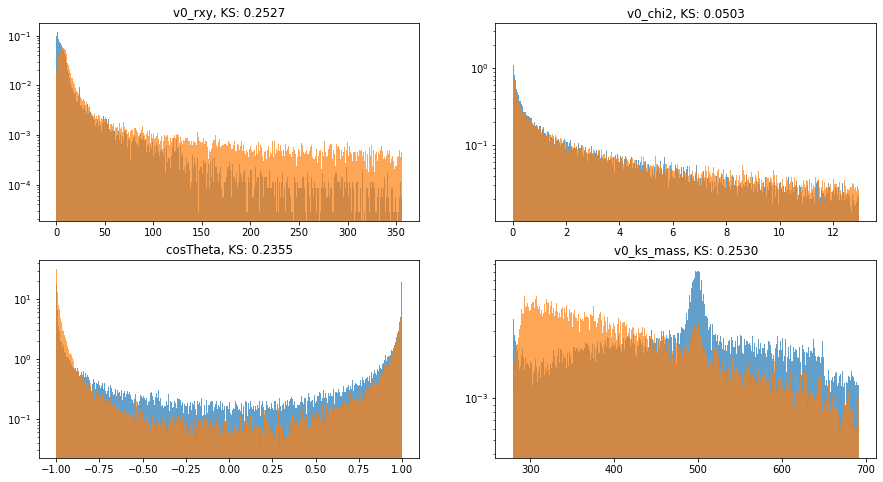

In [7]:
draw_distributions(train_reweight_mc,train_reweight_data,np.ones(subsample))

In [8]:
GBreweighter = GBReweighter(n_estimators=50,learning_rate=0.1,min_samples_leaf=1000,loss_regularization=5.0,gb_args = {'subsample':0.8},max_depth=5)
GBreweighter.fit(original=train_reweight_mc[data.columns],target=train_reweight_data)

GBReweighter(gb_args={'subsample': 0.8}, learning_rate=0.1,
             loss_regularization=5.0, max_depth=5, min_samples_leaf=1000,
             n_estimators=50)

Reweighting training distributions just for investigation:

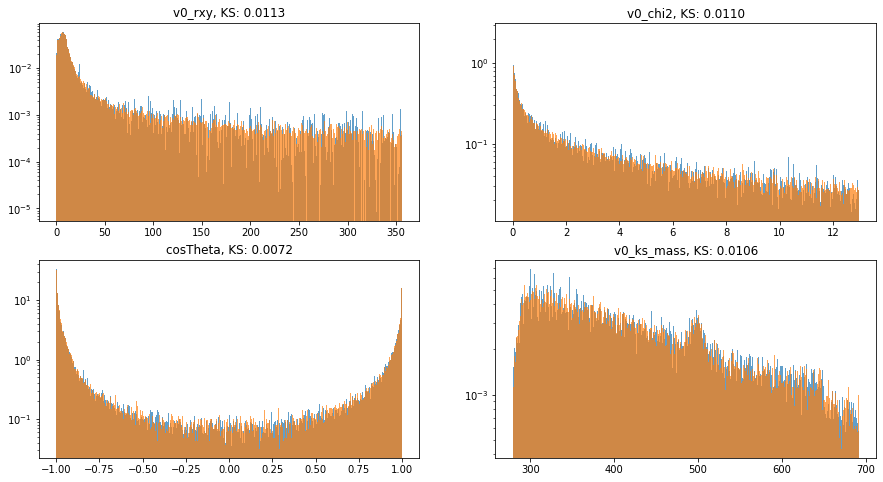

In [9]:
draw_distributions(train_reweight_mc,train_reweight_data,GBreweighter.predict_weights(train_reweight_mc[data.columns]))

Reweighted distributions

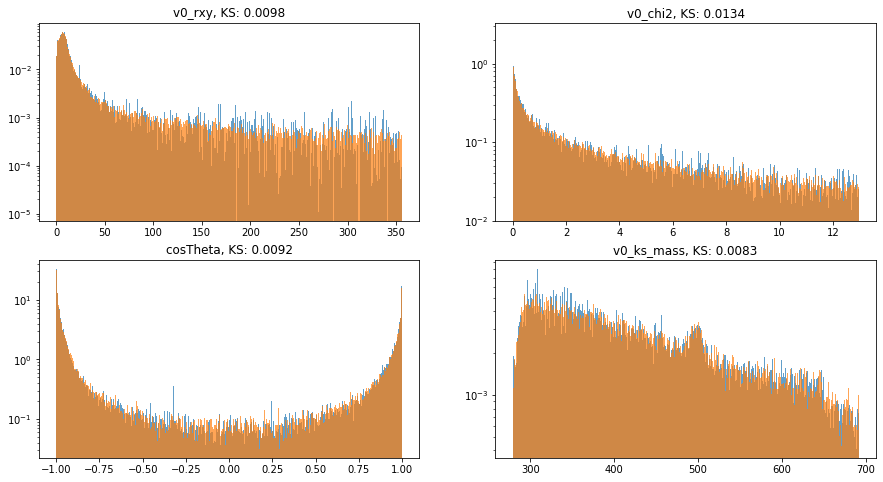

In [10]:
draw_distributions(test_reweight_mc,train_reweight_data,GBreweighter.predict_weights(test_reweight_mc[data.columns]))

Applying sklearn classifiers to see if reweight improves MC:

In [34]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import roc_curve, roc_auc_score

Text(0.5, 1.0, 'ROC curve, AUC: 0.6733110052')

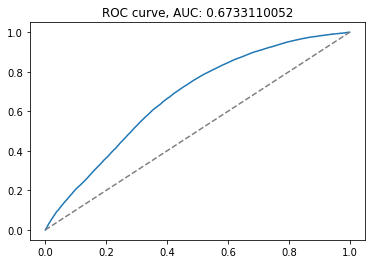

In [44]:
clf = AdaBoostClassifier(n_estimators=100,random_state=42)

clf.fit(X=pd.concat([train_reweight_mc[data.columns],train_classifier_data],axis=0),
        y=np.append(np.zeros(subsample),np.ones(subsample)),
        sample_weight=None)

PID = clf.predict_proba(X=pd.concat([test_classifier_mc[data.columns],test_classifier_data]))

fpr, tpr, thresholds = roc_curve(y_true=np.append(np.zeros(subsample),np.ones(subsample)),
                                y_score=PID[:,0])

fig, ax = plt.subplots()
ax.plot(tpr,fpr)
ax.plot([0,1],[0,1],c='grey',linestyle='--')
ax.set_title(f'ROC curve, AUC: {1-roc_auc_score(y_true=np.append(np.zeros(subsample),np.ones(subsample)),y_score=PID[:,0])}')

Text(0.5, 1.0, 'ROC curve, AUC: 0.5384931018373036')

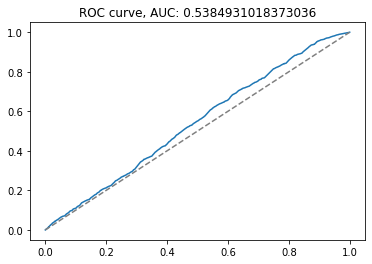

In [46]:
clf = AdaBoostClassifier(n_estimators=100,random_state=42)

reweight = np.append(GBreweighter.predict_weights(train_reweight_mc[data.columns]),np.ones(subsample))

clf.fit(X=pd.concat([train_reweight_mc[data.columns],train_classifier_data],axis=0),
        y=np.append(np.zeros(subsample),np.ones(subsample)),
        sample_weight=reweight)

PID = clf.predict_proba(X=pd.concat([test_classifier_mc[data.columns],test_classifier_data]))

fpr, tpr, thresholds = roc_curve(y_true=np.append(np.zeros(subsample),np.ones(subsample)),
                                y_score=PID[:,0],
                                sample_weight=reweight)

fig, ax = plt.subplots()
ax.plot(tpr,fpr)
ax.plot([0,1],[0,1],c='grey',linestyle='--')
ax.set_title(f'ROC curve, AUC: {1-roc_auc_score(y_true=np.append(np.zeros(subsample),np.ones(subsample)),y_score=PID[:,0],sample_weight=reweight)}')

Quick and dirty investigation of correlation of PID with features

In [14]:
clf = AdaBoostClassifier(n_estimators=100,random_state=42)
clf.fit(mc[2*subsample:3*subsample][data.columns],mc[2*subsample:3*subsample].trueKs)
pred_clean = clf.predict_proba(mc[subsample:2*subsample][data.columns])
clf.score(mc[subsample:2*subsample][data.columns],mc[subsample:2*subsample].trueKs)

0.98286

In [15]:
clf.fit(mc[2*subsample:3*subsample][data.columns],mc[2*subsample:3*subsample].trueKs,GBreweighter.predict_weights(mc[2*subsample:3*subsample][data.columns]))
pred_reweight = clf.predict_proba(mc[subsample:2*subsample][data.columns])
clf.score(mc[subsample:2*subsample][data.columns],mc[subsample:2*subsample].trueKs)

0.98272

(-10, 500)

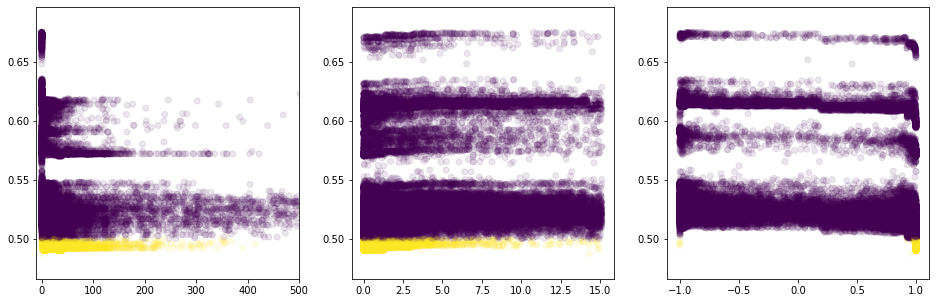

In [16]:
fig, ax = plt.subplots(ncols=3,figsize=(16,5))

for i, feat in enumerate(['v0_rxy', 'v0_chi2', 'cosTheta']):
    ax[i].scatter(mc[subsample:2*subsample][feat],pred_clean[:,0],alpha=0.1,c=pred_clean.argmax(axis=1))
ax[0].set_xlim(-10,500)